In [ ]:

import os
import time
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from tsfresh.utilities.dataframe_functions import impute
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report, roc_auc_score, r2_score
from sklearn.model_selection import train_test_split
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.ensemble import AdaBoostClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.gaussian_process.kernels import RBF
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.neural_network import MLPClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.discriminant_analysis import QuadraticDiscriminantAnalysis

In [38]:
d_icd_diagnoses_df = pd.read_csv("../MIMIC/physionet.org/files/mimiciv/3.1/hosp/d_icd_diagnoses.csv")
diagnoses_icd_df = pd.read_csv("../MIMIC/physionet.org/files/mimiciv/3.1/hosp/diagnoses_icd.csv")
admissions_df = pd.read_csv("../MIMIC/physionet.org/files/mimiciv/3.1/hosp/admissions.csv")
patients_df = pd.read_csv("../MIMIC/physionet.org/files/mimiciv/3.1/hosp/patients.csv")
icustays_df = pd.read_csv("../MIMIC/physionet.org/files/mimiciv/3.1/icu/icustays.csv")

lipid_tests = [50907, 50906, 50905, 50904, 51000]
d_labitems_df = pd.read_csv("../MIMIC/physionet.org/files/mimiciv/3.1/hosp/d_labitems.csv")
d_labitems_df = d_labitems_df[d_labitems_df['itemid'].isin(lipid_tests)]

In [ ]:
chunks = list()

for chunk in pd.read_csv('../MIMIC/physionet.org/files/mimiciv/3.1/hosp/labevents.csv', low_memory=False, chunksize=100000):
    chunk.drop(
        columns=['labevent_id', 'value', 'valueuom', 'flag', 'ref_range_lower', 'ref_range_upper',
                'specimen_id', 'order_provider_id', 'storetime', 'comments'], inplace=True)
    chunk = chunk.merge(d_labitems_df, on=['itemid'], how='inner')
    chunks.append(chunk.groupby(['subject_id', 'hadm_id', 'label', 'itemid', 'charttime'])['valuenum'].median().to_frame().reset_index())
labevents_df = pd.concat(chunks)

In [77]:
# Clean the patients dataframe
patients_df.dropna(subset=['gender', 'anchor_age'], inplace=True)

# Clean the admissions dataframe. Remove any patients with admissions after their discharge, to reduce malformed data.
admissions_df.dropna(subset=['subject_id', 'admittime', 'dischtime'], inplace=True)
admissions_df.admittime = pd.to_datetime(admissions_df.admittime)
admissions_df.dischtime = pd.to_datetime(admissions_df.dischtime)
admissions_df = admissions_df[admissions_df.admittime < admissions_df.dischtime]

# Clean the labevents dataframe. Make sure that all patients have labevents after they are admitted.
labevents_df["charttime"] = pd.to_datetime(labevents_df["charttime"])
labevents_df = labevents_df.dropna(subset=['hadm_id', 'valuenum'])
labevents_df = labevents_df.merge(admissions_df[['hadm_id', 'admittime', 'dischtime']], on='hadm_id')
labevents_df = labevents_df[(labevents_df.charttime >= labevents_df.admittime) & (labevents_df.charttime <= labevents_df.dischtime)]

# Clean the labitems dataframe
d_labitems_df = d_labitems_df.dropna(subset=['itemid', 'label'])

In [78]:
# Merge the patients and admissions dataframes
patients_admissions_df = patients_df.merge(admissions_df, on='subject_id')
patient_features_df = patients_admissions_df[['hadm_id', 'anchor_age', 'gender']].copy()

# Define the age intervals
age_intervals = pd.cut(patient_features_df['anchor_age'], bins=range(0, 100, 10), right=False)
patient_features_df['age_group'] = patient_features_df['anchor_age'].map(age_intervals)
patient_features_df = patient_features_df.drop(columns=['anchor_age'])

# Extract the id's for hyperlipidemia diagnoses
hyperlipidemia_icd_codes = d_icd_diagnoses_df[d_icd_diagnoses_df['long_title'].str.contains('hyperlipidemia', case=False)]['icd_code']
hyperlipidemia_hadm_ids = diagnoses_icd_df[diagnoses_icd_df['icd_code'].isin(hyperlipidemia_icd_codes)]['hadm_id'].unique()

# Create a column to indicate whether a patient has hyperlipidemia to be used as validation during training
patient_features_df['hyperlipidemia'] = patient_features_df['hadm_id'].apply(lambda x: 1 if x in hyperlipidemia_hadm_ids else 0)

In [79]:

feature_df = labevents_df[['hadm_id', 'itemid', 'charttime', 'valuenum']].copy()

# Get the baseline value for each itemid and hadm_id pairing
baseline_df = feature_df.groupby(['hadm_id', 'itemid']).first().reset_index()
baseline_df = baseline_df[['hadm_id', 'itemid', 'valuenum']]
baseline_df = baseline_df.rename(columns={'valuenum': 'baseline_value'})
baseline_df = baseline_df.dropna()

# Calculate the change in lab values from baseline
feature_df = feature_df.merge(baseline_df, on=['hadm_id', 'itemid'])
feature_df['baselinedelta'] = feature_df['valuenum'] - feature_df['baseline_value']
feature_df.sort_values(by=['hadm_id', 'charttime'], inplace=True)

# Calculate the time difference and change over time for variables
feature_df['time_diff_hours'] = feature_df.groupby(['hadm_id', 'itemid'])['charttime'].diff().dt.total_seconds() / 3600.0
feature_df['time_diff_hours'] = feature_df['time_diff_hours'].fillna(0, inplace=True)
feature_df['delta'] = feature_df.groupby(['hadm_id', 'itemid'])['valuenum'].diff()
feature_df['delta'] = feature_df['delta'].fillna(0, inplace=True)
feature_df['rateofchange'] = feature_df['delta'] / (feature_df['time_diff_hours'] / 24.0)
feature_df.replace([np.inf, -np.inf], np.nan, inplace=True) 
feature_df['rateofchange'] = feature_df['rateofchange'].fillna(0, inplace=True)

feature_df.drop(columns=['charttime', 'baseline_value', 'time_diff_hours'], inplace=True)

/tmp/ipykernel_108259/3328258769.py:16: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  feature_df['time_diff_hours'] = feature_df['time_diff_hours'].fillna(0, inplace=True)
/tmp/ipykernel_108259/3328258769.py:18: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 

In [80]:
# Calculate stats for each feature
stats_df = feature_df.groupby(['hadm_id', 'itemid']).agg({
   'valuenum': ['mean', 'median', 'max', 'min', 'std'],
   'baselinedelta': ['mean', 'median', 'max', 'min', 'std'], 
   'delta': ['mean', 'median', 'max', 'min', 'std'],
   'rateofchange': ['mean', 'median', 'max', 'min', 'std']
}).reset_index()
stats_df['itemid'] = stats_df['itemid'].astype(str)
stats_df.columns = ['_'.join(col).strip() for col in stats_df.columns.values]
stats_df.columns = [col[:-1] if col.endswith('_') else col for col in stats_df.columns.values]

# Encode features to have one column corresponding to each labitem
labevent_features_df = stats_df.pivot_table(index=['hadm_id'],columns='itemid',values=[col for col in stats_df.columns if col not in ['hadm_id', 'itemid']])
labevent_features_df.columns = ['_'.join(col).strip() for col in labevent_features_df.columns.values]
labevent_features_df.reset_index(inplace=True)

/home/mloet/miniconda3/envs/health/lib/python3.12/site-packages/numpy/lib/nanfunctions.py:1215: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/mloet/miniconda3/envs/health/lib/python3.12/site-packages/numpy/lib/nanfunctions.py:1215: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/mloet/miniconda3/envs/health/lib/python3.12/site-packages/numpy/lib/nanfunctions.py:1215: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/mloet/miniconda3/envs/health/lib/python3.12/site-packages/numpy/lib/nanfunctions.py:1215: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/mloet/miniconda3/envs/health/lib/python3.12/site-packages/numpy/lib/nanfunctions.py:1215: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/mloet/miniconda3/envs/health/lib/python3.12/site-

KeyboardInterrupt: 

In [144]:
# One-hot encode the categorical features
encoded_features_df = pd.get_dummies(patient_features_df, drop_first=True)

# Infer and scale missing labevent data
imputed_features_df = impute(labevent_features_df)
scaler = StandardScaler()
imputed_features_df.iloc[:, 1:] = scaler.fit_transform(imputed_features_df.iloc[:, 1:])

features = pd.merge(encoded_features_df, imputed_features_df, on='hadm_id')
features = features.drop('hadm_id', axis=1)

In [146]:
# Separate features and target
X = features.drop('hyperlipidemia', axis=1)
y = features['hyperlipidemia']

# Split the data into training and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)


In [147]:

# We will start with a simple multi-layer perceptron model
clf =  MLPClassifier(alpha=1, max_iter=1000, random_state=42)

clf = RandomForestClassifier(n_estimators=300, max_depth=None,
                                        min_samples_split=2, min_samples_leaf=2,
                                        random_state=42, n_jobs=-1)

# Train the classifier
clf.fit(X_train, y_train)

# Print the classification report and ROC AUC
print(classification_report(y_test, clf.predict(X_test)))
print(f'ROC AUC score: {roc_auc_score(y_test, clf.predict_proba(X_test)[:, 1])}')

              precision    recall  f1-score   support

           0       0.65      0.81      0.72      5112
           1       0.52      0.32      0.40      3282

    accuracy                           0.62      8394
   macro avg       0.59      0.57      0.56      8394
weighted avg       0.60      0.62      0.60      8394

ROC AUC score: 0.6250797194637797


In [148]:
# Get feature importances
importances = clf.feature_importances_
importances_df = pd.DataFrame({'feature': X.columns, 'importance': importances})
importances_df = importances_df.sort_values('importance', ascending=False)

importances_df['itemid'] = importances_df['feature'].apply(lambda x: x.split('_')[-1] 
                                                                        if x.startswith(('valuenum', 'rateofchange', 'delta', 'baselinedelta'))
                                                                        else 0).astype(int)

importances_df['label'] = importances_df['itemid'].map(d_labitems_df.set_index('itemid')['label'])
importances_df['label'] = importances_df['label'] + ' (' + importances_df['feature'].apply(lambda x: '_'.join(x.split('_')[0:-1])) + ')'
importances_df['label'] = importances_df['label'].fillna(importances_df['feature'])


In [ ]:
importances_df[['label', 'importance']].head(20)

,label,importance
103,Triglycerides (valuenum_min),0.063754
98,Triglycerides (valuenum_median),0.063658
93,Triglycerides (valuenum_mean),0.063359
88,Triglycerides (valuenum_max),0.062918
87,"Cholesterol, Total (valuenum_max)",0.046510
102,"Cholesterol, Total (valuenum_min)",0.046465
92,"Cholesterol, Total (valuenum_mean)",0.045783
97,"Cholesterol, Total (valuenum_median)",0.045587
100,"Cholesterol, LDL, Calculated (valuenum_min)",0.044231
90,"Cholesterol, LDL, Calculated (valuenum_mean)",0.043961


/tmp/ipykernel_108259/2136054101.py:5: FutureWarning: 

Setting a gradient palette using color= is deprecated and will be removed in v0.14.0. Set `palette='dark:#c44e52'` for the same effect.

  sns.barplot(x='importance', y='label',


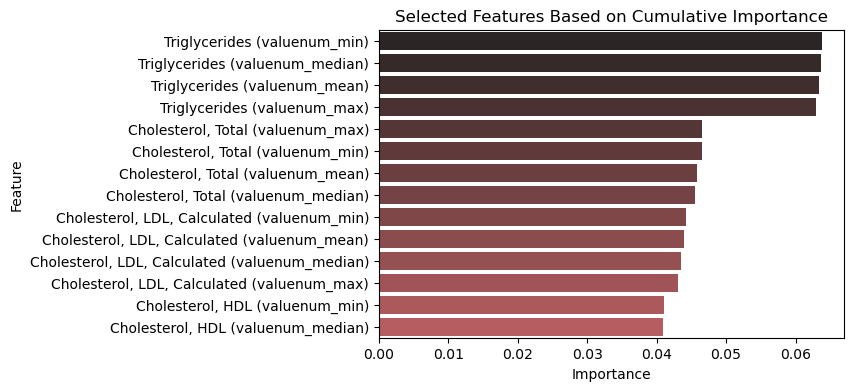

In [150]:

cumulative_importance = np.cumsum(importances_df['importance']).sort_values()
features_to_keep = importances_df['feature'][cumulative_importance <= 0.7]

plt.figure(figsize=(6, 4))
sns.barplot(x='importance', y='label',
          data=importances_df[importances_df['feature'].isin(features_to_keep)],
          color='#c44e52',
          hue='label')
plt.title('Selected Features Based on Cumulative Importance')
plt.xlabel('Importance')
plt.ylabel('Feature')
plt.show()

In [151]:
from sklearn.svm import SVC
from sklearn.naive_bayes import GaussianNB
from sklearn.ensemble import AdaBoostClassifier, ExtraTreesClassifier

X_reduced = X[features_to_keep]

classifiers = {
   'DecisionTree': DecisionTreeClassifier(max_depth=5, random_state=42),
   'RandomForest': RandomForestClassifier(n_estimators=300, max_depth=None,
                                        min_samples_split=2, min_samples_leaf=2,
                                        random_state=42, n_jobs=-1),
   'LogisticRegression': LogisticRegression(max_iter=1000, n_jobs=-1, random_state=42),
   'GradientBoosting': GradientBoostingClassifier(n_estimators=300, random_state=42),
   'Nearest Neighbors': KNeighborsClassifier(n_neighbors=5, n_jobs=-1),
   'MLP': MLPClassifier(alpha=1, max_iter=1000, random_state=42),

   'ExtraTrees': ExtraTreesClassifier(n_estimators=300, random_state=42, n_jobs=-1),
   'SVM': SVC(kernel='rbf', probability=True, random_state=42),
   'AdaBoost': AdaBoostClassifier(algorithm='SAMME', random_state=42),
   'GaussianNB': GaussianNB(),
}

In [ ]:
statistics = {}

X_train, X_test, y_train, y_test = train_test_split(X_reduced, y, test_size=0.15, random_state=42)

for name, clf in classifiers.items():
   clf.fit(X_train, y_train)

   report = classification_report(y_test, clf.predict(X_test), output_dict=True)
   roc_auc = roc_auc_score(y_test, clf.predict_proba(X_test)[:, 1])
   
   y_test_preds = clf.predict(X_test)
   r2 = r2_score(y_test, y_test_preds)
   
   statistics[name] = {
       'report': report,
       'roc_auc': roc_auc,
       'r2': r2
   }
   
   print(f'{name}')
   print(f'Classification Report: \n{classification_report(y_test, clf.predict(X_test))}')
   print(f'ROC AUC: {roc_auc}')
   
   print('----------------------------------------\n')

                    Precision    Recall  Accuracy   ROC-AUC
GradientBoosting     0.591382  0.616988  0.616988  0.608048
DecisionTree         0.583839  0.613295  0.613295  0.601965
AdaBoost             0.579935  0.611389  0.611389  0.599572
SVM                  0.587062  0.612938  0.612938  0.591833
MLP                  0.588898  0.612104  0.612104  0.589539
LogisticRegression   0.529190  0.608053  0.608053  0.573314
RandomForest         0.561193  0.583989  0.583989  0.568262
GaussianNB           0.557329  0.594711  0.594711  0.558656
Nearest Neighbors    0.562447  0.579104  0.579104  0.551555
ExtraTrees           0.558318  0.575054  0.575054  0.546478


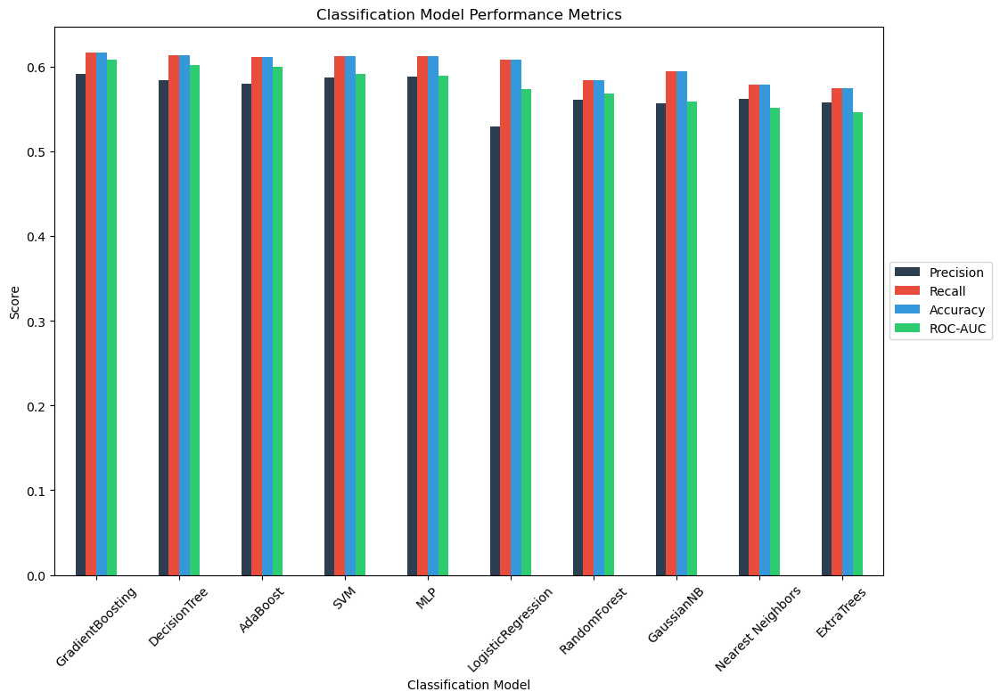

In [98]:

precision = {name: report['weighted avg']['precision'] for name, report in 
           [(name, statistics[name]['report']) for name in statistics.keys()]}

recall = {name: report['weighted avg']['recall'] for name, report in 
        [(name, statistics[name]['report']) for name in statistics.keys()]}

accuracy = {name: report['accuracy'] for name, report in 
          [(name, statistics[name]['report']) for name in statistics.keys()]}

roc_auc = {name: statistics[name]['roc_auc'] for name in statistics.keys()}


metrics_df = pd.DataFrame([precision, recall, accuracy, roc_auc], index=['Precision', 'Recall', 'Accuracy', 'ROC-AUC']).T
metrics_df.sort_values('ROC-AUC', ascending=False, inplace=True)
print(metrics_df)

plt.figure(figsize=(12, 8))
metrics_df.plot(kind='bar', ax=plt.gca(), color = ['#2C3E50', '#E74C3C', '#3498DB', '#2ECC71'])
plt.title('Classification Model Performance Metrics')
plt.ylabel('Score')
plt.xlabel('Classification Model')
plt.xticks(rotation=45)
plt.legend(loc='center left', bbox_to_anchor=(1.0, 0.5))
plt.show()

In [ ]:
import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader

class CustomNet(nn.Module):
    def __init__(self, input_dim, hidden_dims=[256, 128, 64], dropout_rate=0.3):
        super().__init__()
        
        layers = []
        # Input layer
        layers.append(nn.Linear(input_dim, hidden_dims[0]))
        layers.append(nn.BatchNorm1d(hidden_dims[0]))
        layers.append(nn.ReLU())
        layers.append(nn.Dropout(dropout_rate))
        
        # Hidden layers
        for i in range(len(hidden_dims)-1):
            layers.append(nn.Linear(hidden_dims[i], hidden_dims[i+1]))
            layers.append(nn.BatchNorm1d(hidden_dims[i+1]))
            layers.append(nn.ReLU())
            layers.append(nn.Dropout(dropout_rate))
        
        # Output layer
        layers.append(nn.Linear(hidden_dims[-1], 1))
        layers.append(nn.Sigmoid()) 
        
        self.network = nn.Sequential(*layers)
    
    def forward(self, x):
        return self.network(x)

In [113]:
def train_model(model, train_loader, val_loader, criterion, optimizer, scheduler, num_epochs=100):
    best_val_loss = float('inf')
    
    for epoch in range(num_epochs):
        # Training
        model.train()
        train_loss = 0
        for batch_X, batch_y in train_loader:
            optimizer.zero_grad()
            outputs = model(batch_X)
            loss = criterion(outputs, batch_y.unsqueeze(1))
            loss.backward()
            optimizer.step()
            train_loss += loss.item()
            
        # Validation
        model.eval()
        val_loss = 0
        with torch.no_grad():
            for batch_X, batch_y in val_loader:
                outputs = model(batch_X)
                loss = criterion(outputs, batch_y.unsqueeze(1))
                val_loss += loss.item()
        
        # Learning rate scheduling
        scheduler.step(val_loss)
        
        # Save best model
        if val_loss < best_val_loss:
            best_val_loss = val_loss
            torch.save(model.state_dict(), 'best_model.pt')
            
        print(f'Epoch {epoch+1}: Train Loss = {train_loss/len(train_loader):.4f}, Val Loss = {val_loss/len(val_loader):.4f}')
    return model

In [141]:
X_train.info()

<class 'pandas.core.frame.DataFrame'>
Index: 30322 entries, 12124 to 31
Data columns (total 17 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   valuenum_min_51000     30322 non-null  float64
 1   valuenum_median_51000  30322 non-null  float64
 2   valuenum_mean_51000    30322 non-null  float64
 3   valuenum_max_51000     30322 non-null  float64
 4   valuenum_max_50907     30322 non-null  float64
 5   valuenum_min_50907     30322 non-null  float64
 6   valuenum_mean_50907    30322 non-null  float64
 7   valuenum_median_50907  30322 non-null  float64
 8   valuenum_min_50905     30322 non-null  float64
 9   valuenum_mean_50905    30322 non-null  float64
 10  valuenum_median_50905  30322 non-null  float64
 11  valuenum_max_50905     30322 non-null  float64
 12  valuenum_min_50904     30322 non-null  float64
 13  valuenum_median_50904  30322 non-null  float64
 14  valuenum_mean_50904    30322 non-null  float64
 15  valuen

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X_reduced, y, test_size=0.15, random_state=42)
X_train, X_val, y_train, y_val = train_test_split(X_train, y_train, test_size=0.15, random_state=42)

X_train_tensor = torch.FloatTensor(X_train.values) 
X_test_tensor = torch.FloatTensor(X_test.values)
X_val_tensor = torch.FloatTensor(X_test.values)
y_train_tensor = torch.FloatTensor(y_train.values) 
y_test_tensor = torch.FloatTensor(y_test.values)
y_val_tensor = torch.FloatTensor(y_test.values)

# Create Dataset class
class CustomDataset(Dataset):
    def __init__(self, X, y):
        self.X = X
        self.y = y
        
    def __len__(self):
        return len(self.X)
    
    def __getitem__(self, idx):
        return self.X[idx], self.y[idx]

# Create dataset objects
train_dataset = CustomDataset(X_train_tensor, y_train_tensor)
val_dataset = CustomDataset(X_val_tensor, y_val_tensor)
test_dataset = CustomDataset(X_test_tensor, y_test_tensor)

# Create dataloaders
batch_size = 32
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=batch_size)
test_loader = DataLoader(test_dataset, batch_size=batch_size)

input_dim = X_train.shape[1]
model2 = CustomDataset(input_dim=input_dim)

criterion = nn.BCELoss()
optimizer = torch.optim.Adam(model2.parameters(), lr=0.001)
scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode='min', patience=5)

In [ ]:
model = train_model(model2, train_loader, val_loader, criterion, optimizer, scheduler, num_epochs=15)

Epoch 1: Train Loss = 0.6619, Val Loss = 0.6573
Epoch 2: Train Loss = 0.6538, Val Loss = 0.6602
Epoch 3: Train Loss = 0.6518, Val Loss = 0.6677
Epoch 4: Train Loss = 0.6520, Val Loss = 0.6698
Epoch 5: Train Loss = 0.6502, Val Loss = 0.6583
Epoch 6: Train Loss = 0.6502, Val Loss = 0.6574
Epoch 7: Train Loss = 0.6495, Val Loss = 0.6591
Epoch 8: Train Loss = 0.6485, Val Loss = 0.6587
Epoch 9: Train Loss = 0.6476, Val Loss = 0.6583
Epoch 10: Train Loss = 0.6472, Val Loss = 0.6593
Epoch 11: Train Loss = 0.6476, Val Loss = 0.6576
Epoch 12: Train Loss = 0.6481, Val Loss = 0.6572
Epoch 13: Train Loss = 0.6482, Val Loss = 0.6569
Epoch 14: Train Loss = 0.6458, Val Loss = 0.6570
Epoch 15: Train Loss = 0.6466, Val Loss = 0.6577
Epoch 16: Train Loss = 0.6459, Val Loss = 0.6577
Epoch 17: Train Loss = 0.6471, Val Loss = 0.6561
Epoch 18: Train Loss = 0.6466, Val Loss = 0.6581
Epoch 19: Train Loss = 0.6466, Val Loss = 0.6575
Epoch 20: Train Loss = 0.6459, Val Loss = 0.6595
Epoch 21: Train Loss = 0.6468

KeyboardInterrupt: 

In [ ]:
model.eval()  
correct = 0
total = 0

with torch.no_grad():
    for X, y in test_loader:
        
        outputs = model(X)
        predicted = (outputs >= 0.5).float()  
        
        total += y.size(0)
        correct += (predicted.squeeze() == y).sum().item()

accuracy = correct / total
print(f'Test Accuracy: {accuracy:.4f}')

Test Accuracy: 0.6138
